# Understanding Optimization Geometry Through Logistic Regression

This notebook explores the **geometry of gradient descent** by visualizing the loss surface, gradients, and optimization trajectories for binary logistic regression.

**Tools:** NumPy and Matplotlib only. No sklearn.

---
## Section 1: Setup a Simple 2D Dataset

We generate a small **linearly separable** dataset with 2 features. Two classes can be separated by a straight line (the **decision boundary**).

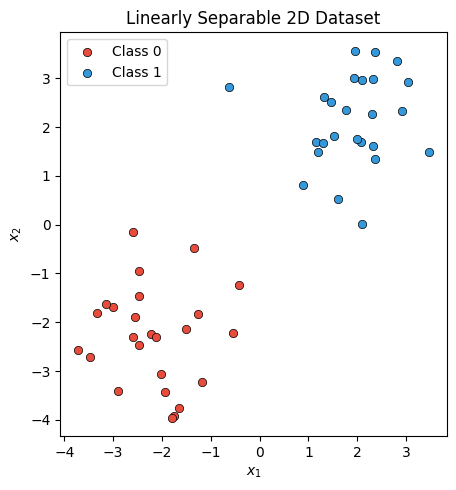

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from model import LogisticRegression
from utils import generate_linearly_separable, plot_x_y, bce_loss

np.random.seed(42)
X, y = generate_linearly_separable(n_per_class=25)
plot_x_y(X, y)

**Decision boundary:** For logistic regression, the decision boundary is where $\mathbf{w}^T \mathbf{x} + b = 0$. This is a straight line in 2D. Points on one side are predicted class 0; on the other, class 1.

---
## Section 2: Define Logistic Regression Loss as Function of Weights

We fix **bias = 0** to simplify the loss landscape to 2D (w1, w2).

- **Sigmoid:** $\sigma(z) = 1 / (1 + e^{-z})$
- **BCE (Binary Cross-Entropy):** $L = -\frac{1}{n}\sum_i \big[ y_i \log(\hat{y}_i) + (1-y_i)\log(1-\hat{y}_i) \big]$
- We define $L(w_1, w_2)$ so we can visualize it over a grid.

In [2]:
model = LogisticRegression(lambda_=0, n_features=2)  # no L2 for geometry viz

def loss_at_weights(w1, w2, X, y, b=0):
    """Compute BCE loss given weights (w1, w2) and fixed bias b. Uses model.sigmoid, utils.bce_loss."""
    w = np.array([w1, w2])
    z = X @ w + b
    y_pred = model.sigmoid(z)
    return bce_loss(y, y_pred)

---
## Section 3: Visualize Loss Surface

We create a grid of (w1, w2) values and compute the loss at each point. The loss surface forms a **convex bowl**: there is a single minimum (for linearly separable data), and moving away from it increases the loss.

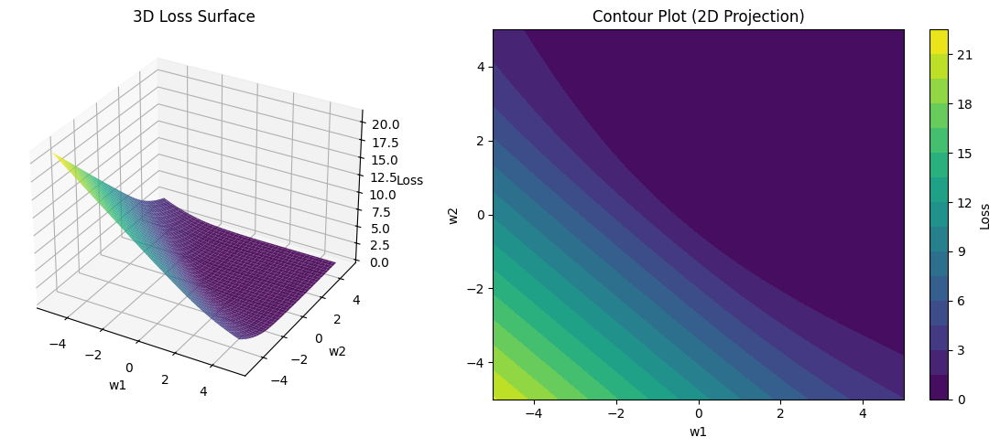

In [3]:
w1_grid = np.linspace(-5, 5, 80)
w2_grid = np.linspace(-5, 5, 80)
W1, W2 = np.meshgrid(w1_grid, w2_grid)

L_grid = np.zeros_like(W1)
for i in range(W1.shape[0]):
    for j in range(W1.shape[1]):
        L_grid[i, j] = loss_at_weights(W1[i, j], W2[i, j], X, y)

fig = plt.figure(figsize=(12, 5))
ax1 = fig.add_subplot(121, projection='3d')
ax1.plot_surface(W1, W2, L_grid, cmap='viridis', alpha=0.9)
ax1.set_xlabel('w1'); ax1.set_ylabel('w2'); ax1.set_zlabel('Loss')
ax1.set_title('3D Loss Surface')

ax2 = fig.add_subplot(122)
cont = ax2.contourf(W1, W2, L_grid, levels=20, cmap='viridis')
ax2.set_xlabel('w1'); ax2.set_ylabel('w2')
ax2.set_title('Contour Plot (2D Projection)')
plt.colorbar(cont, ax=ax2, label='Loss')
plt.tight_layout(); plt.show()

**What does the loss surface look like?**

The loss surface forms a **convex bowl**: a smooth, bowl-shaped surface with a single global minimum. For linearly separable data with BCE loss, the surface has one lowest point; moving away from it in any direction increases the loss. The contours are roughly elliptical (or circular if features are scaled). This convexity guarantees that gradient descent, with an appropriate learning rate, will converge to the unique minimum.

**Animation:** 3D loss surface rotation.

In [14]:
# Animation: 3D loss surface rotation
fig = plt.figure(figsize=(6, 5))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(W1, W2, L_grid, cmap='viridis', alpha=0.9)
ax.set_xlabel('w1'); ax.set_ylabel('w2'); ax.set_zlabel('Loss')
ax.set_title('Loss Surface (3D)')

def update_3d(frame):
    ax.view_init(elev=20, azim=frame)
    return ()

anim = FuncAnimation(fig, update_3d, frames=np.arange(0, 360, 2), interval=50, blit=False)
plt.close(fig)
HTML(anim.to_jshtml())

---
## Section 4: Compute Gradient at Any Point

The analytic gradient for BCE + sigmoid is:
$$\frac{\partial L}{\partial w} = \frac{1}{n} \sum_i (\hat{y}_i - y_i) \, x_i$$

The gradient points in the direction of steepest **ascent**. Gradient descent moves in the **opposite** direction. The gradient is **perpendicular** to contour lines.

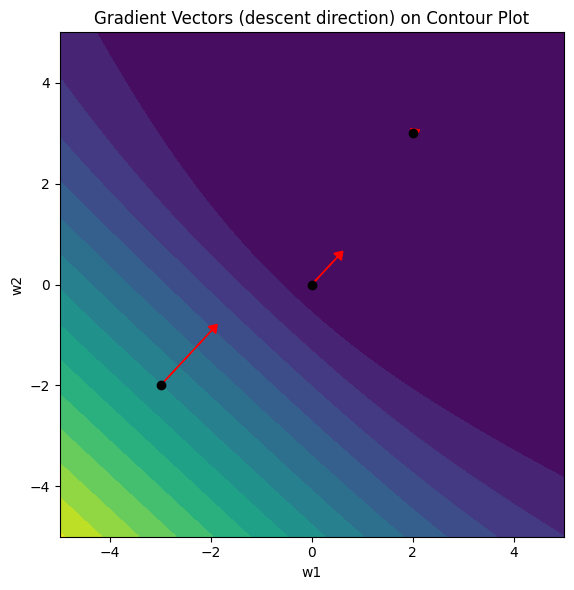

In [15]:
def gradient_at_weights(w1, w2, X, y, b=0):
    """Compute BCE gradient at (w1, w2). Uses model.sigmoid and model.gradient."""
    w = np.array([w1, w2])
    model.weights = w
    model.bias = b
    z = model.linear_forward(X)
    y_pred = model.sigmoid(z)
    grad_w, _ = model.gradient(X, y, y_pred)
    return grad_w[0], grad_w[1]

# Pick a few points and compute gradients
pts = [(-3, -2), (2, 3), (0, 0)]

fig, ax = plt.subplots(figsize=(7, 6))
ax.contourf(W1, W2, L_grid, levels=20, cmap='viridis')
ax.set_xlabel('w1'); ax.set_ylabel('w2')

scale = 0.5  # Scale for visibility
for pw1, pw2 in pts:
    g1, g2 = gradient_at_weights(pw1, pw2, X, y)
    ax.arrow(pw1, pw2, -scale*g1, -scale*g2, head_width=0.2, head_length=0.15, fc='red', ec='red')
    ax.plot(pw1, pw2, 'ko', markersize=6)

ax.set_title('Gradient Vectors (descent direction) on Contour Plot')
ax.set_aspect('equal')
plt.tight_layout(); plt.show()

**Why is the gradient perpendicular to contour lines?**

Let's make this concrete using math and an example!

Consider the loss function L(w1, w2). A contour line or "level curve" is the set of points (w1, w2) such that L(w1, w2) = constant.
Now, recall from multivariable calculus: the gradient vector ∇L = [∂L/∂w1, ∂L/∂w2] points in the direction where the loss increases fastest.
If you move *along* a contour line, the loss doesn’t change (since you stay on the same level curve). Mathematically, this means the rate of change (directional derivative) of L in the tangent direction v of the contour is zero. 

The directional derivative is given by: 
    D_v L = ∇L • v = 0
The only way the dot product of ∇L and v is zero is if ∇L is perpendicular (orthogonal) to v — that is, the gradient is perpendicular to the contour line.

**Example:**  
Suppose L(w1, w2) = w1² + w2² (a circular contour, like a bowl).
- The gradient at point (w1, w2) is ∇L = [2w1, 2w2].
- For any point on the circle w1² + w2² = c², the tangent direction is perpendicular to [w1, w2].
- Thus, the gradient points straight outward from the center, and is perpendicular to the circle at every point.

In summary: the gradient always points directly away from (or toward) the center of a contour, perpendicular to the contour itself. Gradient descent steps *across* contours, following −∇L to lower the loss.

**Animation:** Gradient vectors stay perpendicular to contours as a point moves.

In [18]:
# Animation: Show *actual* gradient descent path step by step with gradient vectors

# Run a single GD trajectory for animation (starting from a random point)
m_anim = LogisticRegression(lr=0.5, epochs=60, lambda_=0, n_features=2)
m_anim.weights, m_anim.bias = m_anim.init_weights_and_bias(X.shape[1])
path_anim = [(m_anim.weights[0], m_anim.weights[1])]
grads_anim = []

for _ in range(60):
    _, y_pred = m_anim.forward(X)
    g1, g2 = m_anim.gradient(X, y, y_pred)[0][:2]
    grads_anim.append((g1, g2))
    m_anim.update_weights(X, y, y_pred)
    path_anim.append((m_anim.weights[0], m_anim.weights[1]))

path_anim = np.array(path_anim)
scale = 0.4

fig, ax = plt.subplots(figsize=(7, 6))
ax.contourf(W1, W2, L_grid, levels=20, cmap='viridis')
ax.set_xlabel('w1'); ax.set_ylabel('w2')
point_plot, = ax.plot([], [], 'ko', markersize=8)
arrows = []

def init_grad():
    point_plot.set_data([], [])
    return (point_plot,)

def update_grad(frame):
    for a in arrows:
        a.remove()
    arrows.clear()
    pw1, pw2 = path_anim[frame]
    g1, g2 = grads_anim[frame] if frame < len(grads_anim) else (0,0)
    point_plot.set_data([pw1], [pw2])
    arr = ax.arrow(pw1, pw2, -scale * g1, -scale * g2, head_width=0.2, head_length=0.15, fc='red', ec='red')
    arrows.append(arr)
    ax.set_title(f'Gradient descent (step {frame+1}/{len(grads_anim)})')
    return (point_plot,)

anim = FuncAnimation(fig, update_grad, init_func=init_grad, frames=len(grads_anim), interval=80, blit=False)
ax.set_aspect('equal')
plt.close(fig)
HTML(anim.to_jshtml())

---
# Section 5: Gradient Descent Trajectory

We run gradient descent from random initial weights, track the path, and overlay it on the contour plot.

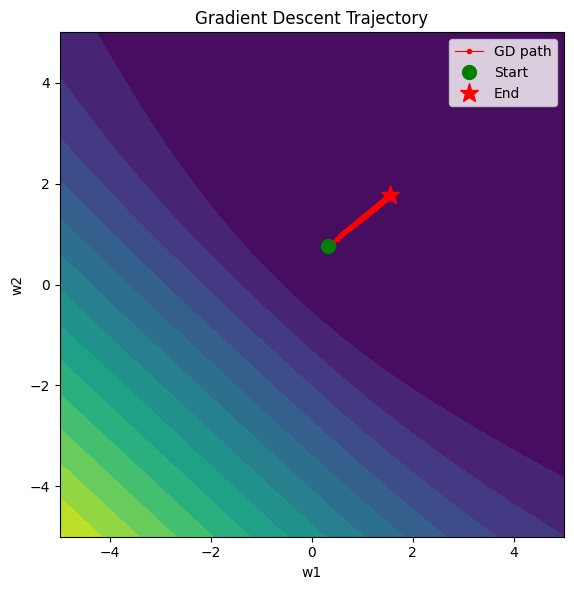

In [20]:
def gradient_descent(X, y, lr=0.5, epochs=100):
    """Run gradient descent using model.LogisticRegression (forward, loss, update_weights)."""
    m = LogisticRegression(lr=lr, epochs=epochs, lambda_=0, n_features=2)
    m.weights, m.bias = m.init_weights_and_bias(X.shape[1])
    path = [(m.weights[0], m.weights[1])]
    losses, grad_norms = [], []
    for _ in range(epochs):
        z, y_pred = m.forward(X)
        loss = m.loss(y, y_pred, loss_type='bce')
        m.update_weights(X, y, y_pred)
        path.append((m.weights[0], m.weights[1]))
        losses.append(loss)
        grad_norms.append(m.grad_norms[-1])
    return np.array(path), losses, grad_norms

np.random.seed(42)
path, losses, grad_norms = gradient_descent(X, y, lr=0.5, epochs=100)

fig, ax = plt.subplots(figsize=(7, 6))
ax.contourf(W1, W2, L_grid, levels=20, cmap='viridis')
ax.plot(path[:, 0], path[:, 1], 'r-o', markersize=3, linewidth=0.8, label='GD path')
ax.plot(path[0, 0], path[0, 1], 'go', markersize=10, label='Start')
ax.plot(path[-1, 0], path[-1, 1], 'r*', markersize=14, label='End')
ax.set_xlabel('w1'); ax.set_ylabel('w2')
ax.set_title('Gradient Descent Trajectory')
ax.legend(); ax.set_aspect('equal')
plt.tight_layout(); plt.show()

The path converges to the minimum of the loss surface.

---
## Section 6: Learning Rate Experiments

We compare three learning rates:
- **Small:** Slow convergence
- **Good:** Smooth, efficient convergence
- **Too large:** Divergence or oscillation

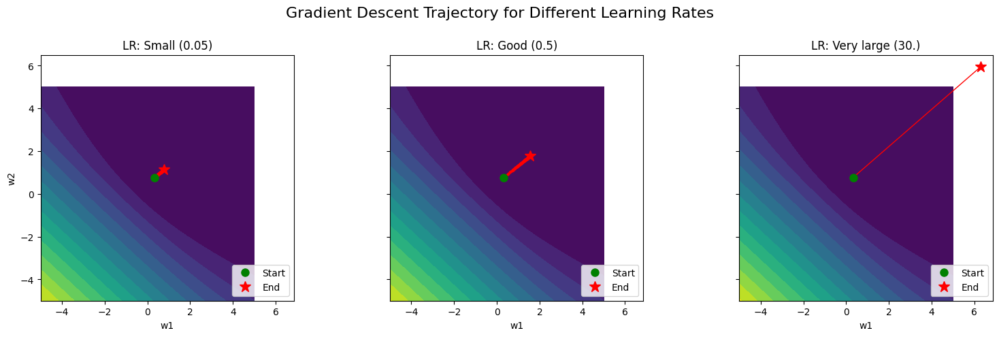

In [34]:
lrs = [0.05, 0.5, 30.]
labels = ['Small (0.05)', 'Good (0.5)', 'Very large (30.)']

fig, axes = plt.subplots(1, len(labels), figsize=(16, 5), sharex=True, sharey=True)
for ax, lr, label in zip(axes, lrs, labels):
    np.random.seed(42)
    path, _, _ = gradient_descent(X, y, lr=lr, epochs=100)
    ax.contourf(W1, W2, L_grid, levels=20, cmap='viridis')
    ax.plot(path[:, 0], path[:, 1], '-o', markersize=2, linewidth=1, color='r')
    ax.plot(path[0, 0], path[0, 1], 'go', markersize=8, label='Start')
    ax.plot(path[-1, 0], path[-1, 1], 'r*', markersize=12, label='End')
    ax.set_title(f'LR: {label}')
    ax.set_xlabel('w1')
    ax.set_aspect('equal')
    ax.legend(loc='lower right')

axes[0].set_ylabel('w2')
plt.suptitle('Gradient Descent Trajectory for Different Learning Rates', fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

**Animation:** Learning rate trajectories building step by step.

In [35]:
# Animation: Sequentially build learning rate trajectories (show one after the other)
lrs_anim = lrs
labels_anim = labels
colors_anim = ['#3498db', '#2ecc71', '#e74c3c']
paths_lr = []
for lr in lrs_anim:
    np.random.seed(42)
    p, _, _ = gradient_descent(X, y, lr=lr, epochs=100)
    paths_lr.append(p)
lens = [len(p) for p in paths_lr]
cum_lens = [sum(lens[:i+1]) for i in range(len(lens))]
total_frames = sum(lens)

fig, ax = plt.subplots(figsize=(8, 6))
ax.contourf(W1, W2, L_grid, levels=20, cmap='viridis')
ax.set_xlabel('w1')
ax.set_ylabel('w2')
lines = []
for c, l in zip(colors_anim, labels_anim):
    line, = ax.plot([], [], '-o', color=c, markersize=2, linewidth=1, label=l)
    lines.append(line)

def init_lr():
    for line in lines:
        line.set_data([], [])
    return tuple(lines)

def update_lr_sequential(frame):
    # For each trajectory, reveal only after the previous has finished
    for traj_idx, (path, start_at) in enumerate(zip(paths_lr, [0] + cum_lens[:-1])):
        # Is this trajectory's turn yet?
        if frame >= start_at:
            steps = min(frame - start_at + 1, len(path))
            lines[traj_idx].set_data(path[:steps, 0], path[:steps, 1])
        else:
            # Not started yet
            lines[traj_idx].set_data([], [])
    # Dynamic title reflecting current run and epoch
    for idx, start_at in enumerate([0] + cum_lens[:-1]):
        end_at = cum_lens[idx]
        if start_at <= frame < end_at:
            local_epoch = frame - start_at
            ax.set_title(f"Trajectory: {labels_anim[idx]} | Epoch {local_epoch}")
            break
    else:
        ax.set_title("All Trajectories Complete")
    return tuple(lines)

anim = FuncAnimation(fig, update_lr_sequential, init_func=init_lr, frames=total_frames, interval=50, blit=True)
ax.legend()
ax.set_aspect('equal')
plt.close(fig)
HTML(anim.to_jshtml())

**Why does learning rate matter?**

The learning rate controls the step size. **Small lr:** Many tiny steps—progress is slow but stable. **Good lr:** Steps are large enough to move efficiently toward the minimum without overshooting. **Too large lr:** Steps overshoot the minimum; the next gradient points back, causing oscillation or divergence.

**Why does too-large learning rate diverge?**

When the step size exceeds the "width" of the loss bowl, each update overshoots the minimum. You land on the opposite side where the gradient points the other way. With a very large lr, the next step overshoots again, even farther. The loss can increase each step, and weights may grow unbounded—**divergence**. With a moderately large lr, you may **oscillate** around the minimum without ever settling.

---
## Section 7: Feature Scaling Effect

Multiply one feature by 1000. This creates an **ill-conditioned** problem: the loss contour becomes elongated (elliptical). Gradient descent zig-zags along the narrow valley, making progress very slow. This is the **conditioning problem**.

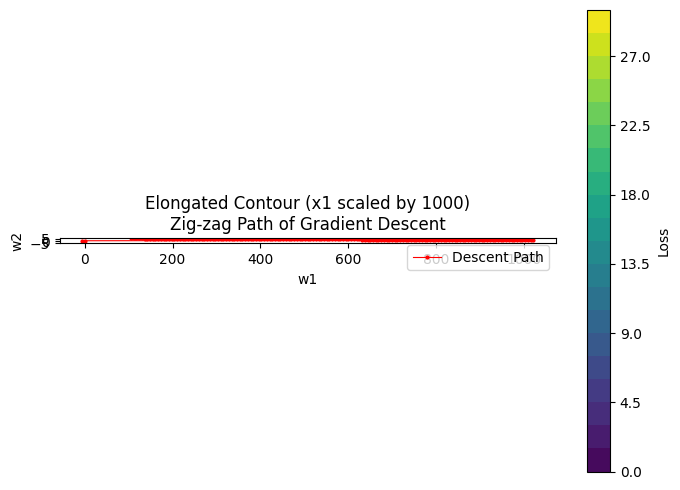

In [38]:
# --- Zig-zag due to ill-conditioning: static plot only ---

X_scaled = X.copy()
X_scaled[:, 0] *= 1000  # Unbalanced feature scales

w1_s = np.linspace(-0.01, 0.01, 100)
w2_s = np.linspace(-5, 5, 100)
W1_s, W2_s = np.meshgrid(w1_s, w2_s)

L_grid_s = np.zeros_like(W1_s)
for i in range(W1_s.shape[0]):
    for j in range(W1_s.shape[1]):
        L_grid_s[i, j] = loss_at_weights(W1_s[i, j], W2_s[i, j], X_scaled, y)

# Run gradient descent to get the zig-zag path
np.random.seed(42)
path_s, _, _ = gradient_descent(X_scaled, y, lr=0.5, epochs=150)

# Plot only the static zig-zag: contour + full zig-zag curve
plt.figure(figsize=(7, 5))
cont = plt.contourf(W1_s, W2_s, L_grid_s, levels=20, cmap='viridis')
plt.xlabel('w1')
plt.ylabel('w2')
plt.title('Elongated Contour (x1 scaled by 1000)\nZig-zag Path of Gradient Descent')
plt.plot(path_s[:, 0], path_s[:, 1], 'r-o', markersize=2, linewidth=0.8, label="Descent Path")
plt.colorbar(cont, label='Loss')
plt.legend()
plt.gca().set_aspect('equal')
plt.tight_layout()
plt.show()

**Why do poorly scaled features cause zig-zagging?**

When one feature has much larger scale than another (e.g., x1 × 1000), the loss contour becomes **elongated** (a narrow valley). The gradient points mostly along the steep direction (across the valley). A step of fixed size overshoots the narrow dimension, so the next gradient points back. You zig-zag down the valley instead of moving directly to the minimum. This is the **conditioning problem**: the loss surface is ill-conditioned when feature scales differ greatly.

**Takeaway:** Standardizing features (zero mean, unit variance) makes contours more circular and gradient descent faster.

---
## Section 8: Gradient Norm Analysis

We track $\|\nabla L\|$ over iterations. As we approach the minimum, the gradient shrinks: we are in a flatter region. A shrinking gradient norm indicates convergence.

**Animation:** Path building + gradient norm over epochs.

In [42]:
# Animation: Path building + gradient norm over time
np.random.seed(42)
path_gn, losses_gn, grad_norms_gn = gradient_descent(X, y, lr=0.5, epochs=100)

fig, axes = plt.subplots(1, 2, figsize=(10, 4))
ax1, ax2 = axes
ax1.contourf(W1, W2, L_grid, levels=20, cmap='viridis')
ax1.set_xlabel('w1'); ax1.set_ylabel('w2'); ax1.set_aspect('equal')
path_line, = ax1.plot([], [], 'r-o', markersize=3, linewidth=0.8)
ax1.plot(path_gn[0, 0], path_gn[0, 1], 'go', markersize=8)
ax1.plot(path_gn[-1, 0], path_gn[-1, 1], 'r*', markersize=12)

ax2.set_xlim(0, len(losses_gn))
ax2.set_ylim(0, max(grad_norms_gn) * 1.1)
ax2.set_xlabel('Epoch'); ax2.set_ylabel('Gradient Norm')
gn_line, = ax2.plot([], [], 'b-', lw=1.5)
ax2.grid(alpha=0.3)

def init_gn():
    path_line.set_data([], [])
    gn_line.set_data([], [])
    return (path_line, gn_line)

def update_gn(frame):
    n = min(frame + 1, len(path_gn))
    path_line.set_data(path_gn[:n, 0], path_gn[:n, 1])
    gn_line.set_data(list(range(n - 1)), grad_norms_gn[:n - 1])
    ax2.set_title(f'Epoch {n - 1}')
    return (path_line, gn_line)

anim = FuncAnimation(fig, update_gn, init_func=init_gn, frames=len(path_gn), interval=50, blit=True)
plt.close(fig)
HTML(anim.to_jshtml())

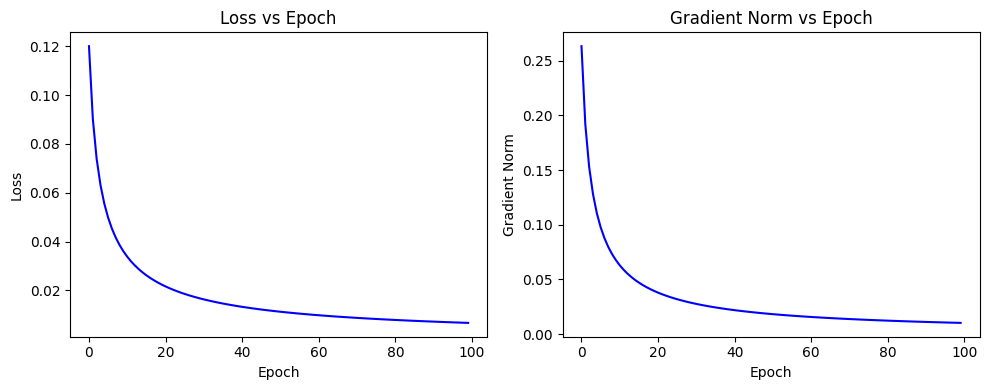

In [40]:
np.random.seed(42)
_, losses, grad_norms = gradient_descent(X, y, lr=0.5, epochs=100)

fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].plot(losses, 'b-')
axes[0].set_xlabel('Epoch'); axes[0].set_ylabel('Loss')
axes[0].set_title('Loss vs Epoch')

axes[1].plot(grad_norms, 'b-')
axes[1].set_xlabel('Epoch'); axes[1].set_ylabel('Gradient Norm')
axes[1].set_title('Gradient Norm vs Epoch')
plt.tight_layout(); plt.show()

**What does the gradient norm tell us?**

The gradient norm ‖∇L‖ measures how steep the loss surface is at the current point. As we approach the minimum, the surface flattens—the gradient shrinks. So:

- **Shrinking gradient norm** → We are in a flatter region; we're nearing the optimum; step sizes get smaller, stabilizing convergence.
- **Large, persistent gradient norm** → The loss is still steep; we haven't converged.
- **Near-zero gradient norm** → We're at (or very near) a stationary point (minimum, saddle, or plateau).

Monitoring ‖∇L‖ over epochs is a useful convergence diagnostic: when it approaches zero, training has effectively converged.